In [1]:
import os
import numpy as np
import PIL as pil 
from matplotlib import pyplot as plt

In [2]:
# Data Set 
dataset_path = os.path.join ( os.getcwd() , "Datasets", "Raw_Images") 
data = os.listdir(dataset_path)

data = [os.path.join(dataset_path, img) for img in data]

print(data[0:5])  

print("Total number of images: ", len(data))

['c:\\Users\\harsh\\OneDrive\\Desktop\\digantara\\Datasets\\Raw_Images\\Raw_Observation_001_Set1.tiff', 'c:\\Users\\harsh\\OneDrive\\Desktop\\digantara\\Datasets\\Raw_Images\\Raw_Observation_002_Set1.tiff', 'c:\\Users\\harsh\\OneDrive\\Desktop\\digantara\\Datasets\\Raw_Images\\Raw_Observation_003_Set1.tiff', 'c:\\Users\\harsh\\OneDrive\\Desktop\\digantara\\Datasets\\Raw_Images\\Raw_Observation_004_Set1.tiff', 'c:\\Users\\harsh\\OneDrive\\Desktop\\digantara\\Datasets\\Raw_Images\\Raw_Observation_005_Set1.tiff']
Total number of images:  35


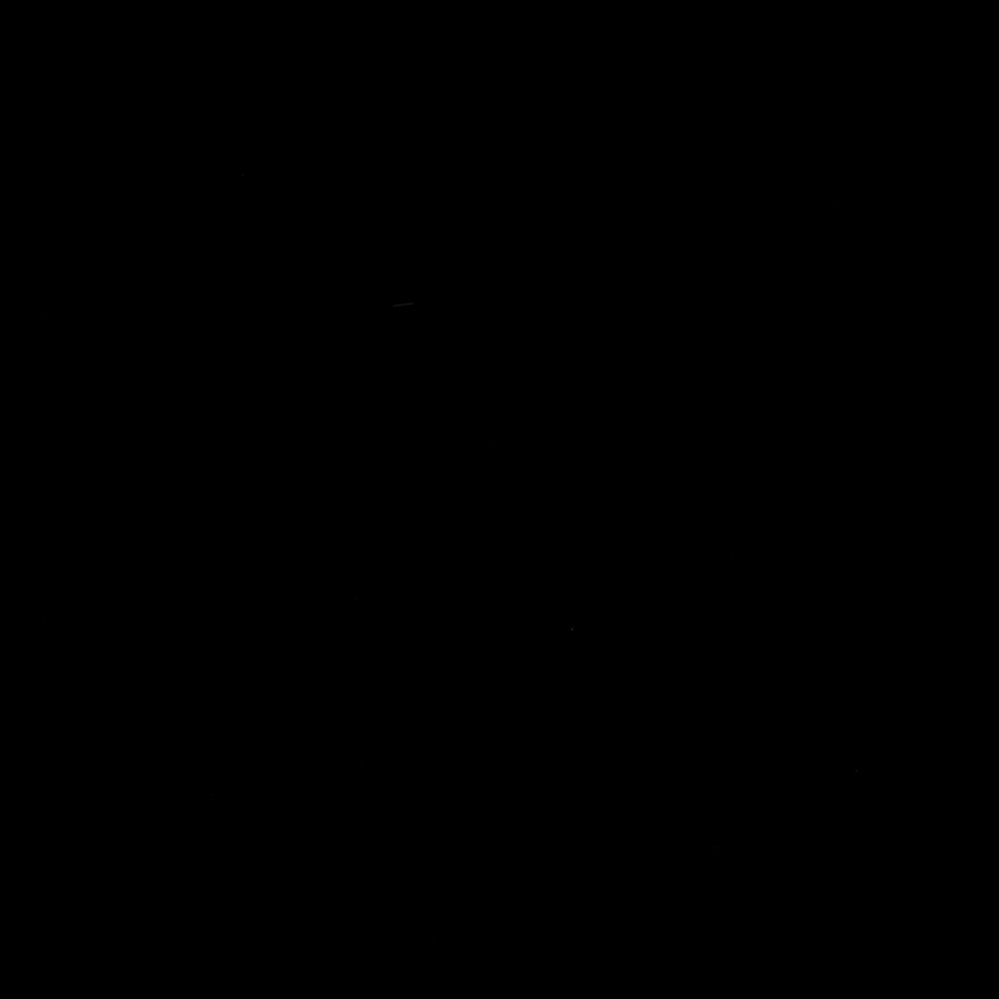

In [3]:
img = pil.Image.open(data[4])
img

In [4]:
# all attributes of the img object
for key in img.__dict__.keys():
    print(key, " : ", img.__dict__[key])

_im  :  <ImagingCore object at 0x000001A4F1ACB7F0>
_mode  :  I;16
_size  :  (4418, 4418)
palette  :  None
info  :  {'compression': 'raw', 'dpi': (1, 1), 'resolution': (1, 1)}
_readonly  :  0
_exif  :  {256: 4418, 257: 4418, 258: 16, 259: 1, 262: 1, 273: (8, 8844, 17680, 26516, 35352, 44188, 53024, 61860, 70696, 79532, 88368, 97204, 106040, 114876, 123712, 132548, 141384, 150220, 159056, 167892, 176728, 185564, 194400, 203236, 212072, 220908, 229744, 238580, 247416, 256252, 265088, 273924, 282760, 291596, 300432, 309268, 318104, 326940, 335776, 344612, 353448, 362284, 371120, 379956, 388792, 397628, 406464, 415300, 424136, 432972, 441808, 450644, 459480, 468316, 477152, 485988, 494824, 503660, 512496, 521332, 530168, 539004, 547840, 556676, 565512, 574348, 583184, 592020, 600856, 609692, 618528, 627364, 636200, 645036, 653872, 662708, 671544, 680380, 689216, 698052, 706888, 715724, 724560, 733396, 742232, 751068, 759904, 768740, 777576, 786412, 795248, 804084, 812920, 821756, 830592, 83

In [13]:
# img to numpy array
img_arr= np.array(img, dtype=np.uint16)
print("Image shape: ", img_arr.shape)

Image shape:  (4418, 4418)


In [14]:
# mean, standard deviation, min and max 
mean = np.mean(img_arr)
std = np.std(img_arr)
min = np.min(img_arr)
max = np.max(img_arr)

print("Mean: ", mean)
print("Standard Deviation: ", std)
print("Min: ", min)
print("Max: ", max)

Mean:  44.014014696862354
Standard Deviation:  39.83781735694086
Min:  0
Max:  9596


Image shape after normalization:  (4418, 4418)


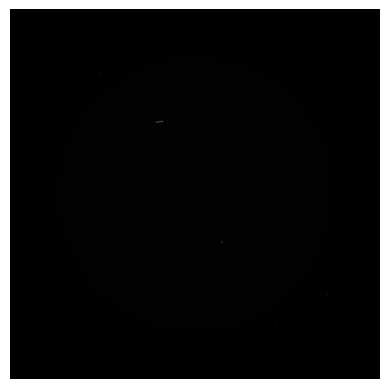

In [15]:
# min max normalization
img_arr = (img_arr - min) / (max - min) * 255 
img_arr = img_arr.astype(np.uint8)
print("Image shape after normalization: ", img_arr.shape)

# show the image
plt.imshow(img_arr, cmap='gray')
plt.axis('off')
plt.show()

In [24]:
min = np.min(img_arr)
max = np.max(img_arr)
mean = np.mean(img_arr)
std = np.std(img_arr)

print(f"Mean : {mean}, Standard Deviation : {std}, Min : {min}, Max : {max}")

Mean : 0.8251187423932015, Standard Deviation : 0.9909766066422228, Min : 0, Max : 255


In [25]:
import cv2 as cv

In [ ]:
# apply brightness and contrast to image
brightness = 50
contrast = 30
pre_img = cv.convertScaleAbs(img_arr,alpha=contrast, beta=brightness )
plt.figure(figsize=(20,10))
plt.imshow(pre_img, cmap='gray')
plt.title(f"Brightness : {brightness} and Contrast : {contrast}")
plt.axis('off')
plt.show()

NameError: name 'cv' is not defined

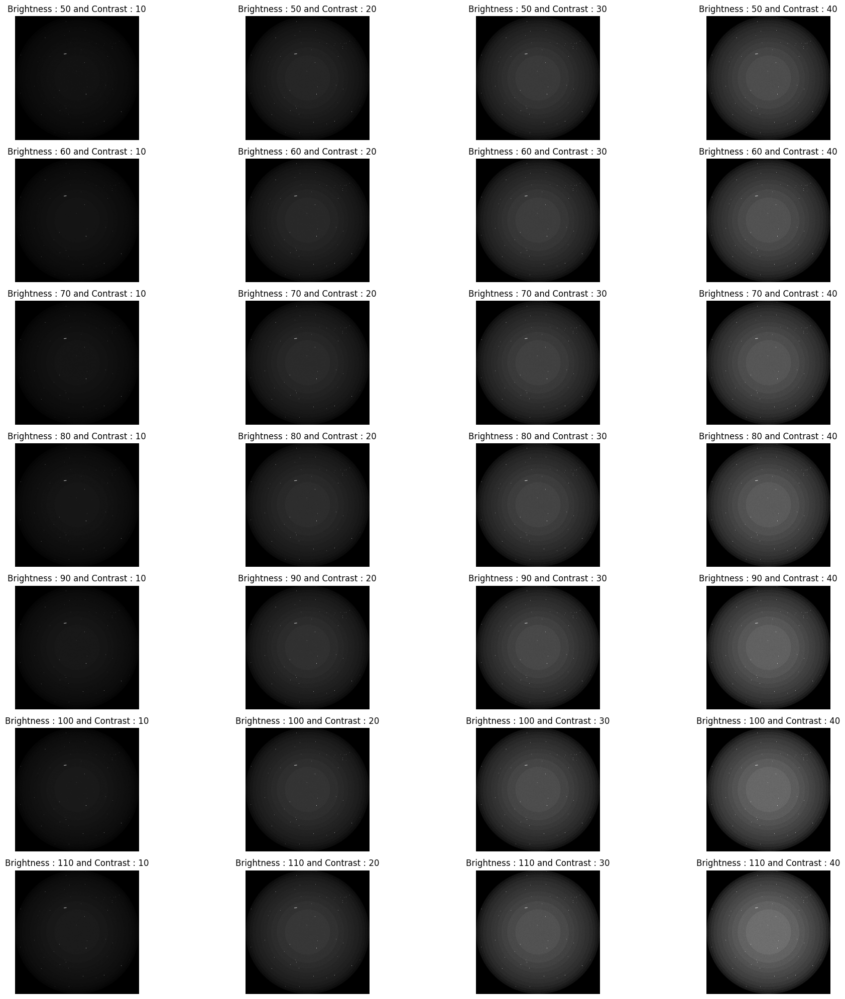

In [ ]:
# make a grid a multiple images with constant from 10 to 50 and brightness from 50 to 120 
brightness = np.arange(50, 120, 10)
contrast = np.arange(10, 50, 10)
fig, axs = plt.subplots(len(brightness), len(contrast), figsize=(20, 20))
for i in range(len(brightness)):
    for j in range(len(contrast)):
        pre_img = cv.convertScaleAbs(img_arr, alpha=contrast[j], beta=brightness[i])
        axs[i, j].imshow(pre_img, cmap='gray')
        axs[i, j].set_title(f"Brightness : {brightness[i]} and Contrast : {contrast[j]}")
        axs[i, j].axis('off')
plt.tight_layout()
plt.show()

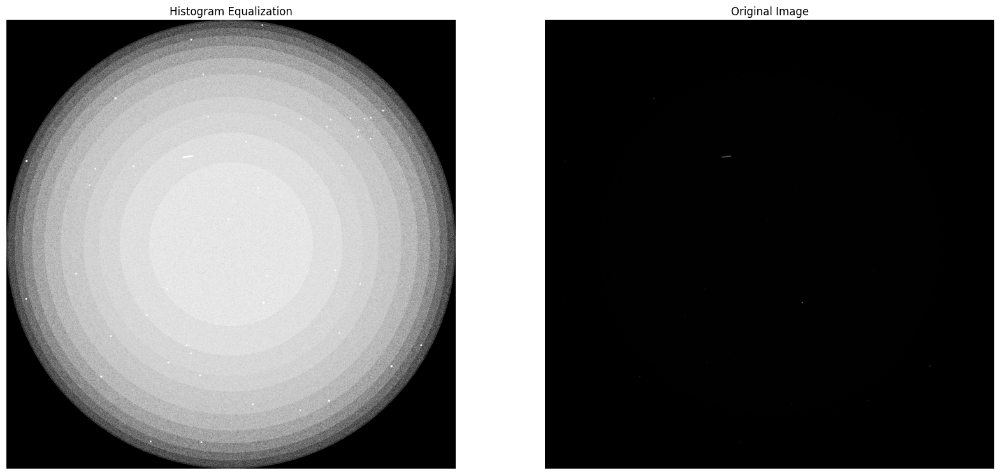

In [66]:
# apply histogram equalization
img_arr_equ = cv.equalizeHist(img_arr)
plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.imshow(img_arr_equ, cmap='gray')
plt.title("Histogram Equalization")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img_arr, cmap='gray')
plt.title("Original Image")
plt.axis('off')
plt.show()

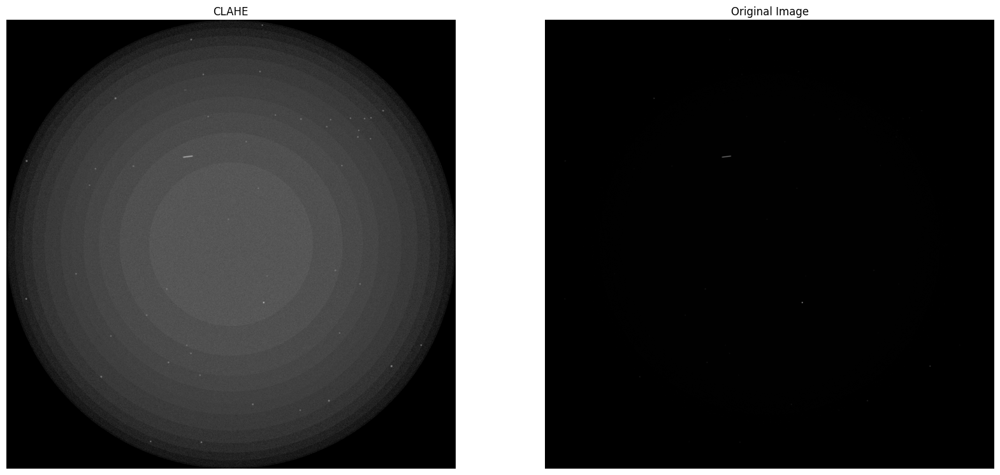

In [75]:
# appoly CLAHE 
clahe = cv.createCLAHE(clipLimit=50.0, tileGridSize=(2, 2))
img_arr_clahe = clahe.apply(img_arr)

plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.imshow(img_arr_clahe, cmap='gray')
plt.title("CLAHE")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img_arr, cmap='gray')
plt.title("Original Image")
plt.axis('off')
plt.show()